# Pokemon Generation using Deep Convolutional Generative Adversarial Networks

## Imports

In [0]:
from __future__ import print_function
#%matplotlib inline
import os
import random
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
import torch.optim as optim
import torch.autograd as autograd
import torchvision.datasets as datasets
import torchvision.transforms as transforms
import torchvision.utils as vutils
from matplotlib import animation
from IPython.display import HTML
from torchsummary import summary

## Connect to drive

In order to use pokemon data you need to get data from [this Github project](https://github.com/DonaCrio/Pokemon-dataset).\
**Do not forget to change the `prefix` variable to the path to your data.**

In [2]:
from google.colab import drive
drive.mount('/content/gdrive')
prefix = "gdrive/My Drive/ECP/DL"

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


## Parameters input

In [3]:
# Set the seed manually or randomly

seed = 40 # Use 'random.randint(1, 10000)' to deactivate reproductability
print("seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

seed:  40


In [4]:
# Uses the Colab GPU as a device if available

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [0]:
# Set all the parameters

# Size of z latent vector# Root directory of the dataset
PATH_DATA = os.path.join(prefix, "data")
# Number of channels per image
IMG_N_CHANNELS = 3 #@param {type: "integer", default: 3}
# Rescale size before random crop
IMG_RESCALE_SIZE = 300 #@param {type: "integer", default: 300}
# Final size of the image
IMG_SIZE = 256 #@param {type: "integer", default: 256}
# Number of workers for dataloader
N_WORKERS =  2 #@param {type: "integer", default: 2}

# Size of the latent vector
LATENT_VECTOR_SIZE =  100 #@param {type:'integer', default: 64}
# Size of the base feature map in generator
G_FEATURE_SIZE = 64 #@param {type:'integer', default: 64}
# Size of the base feature map in discriminator
D_FEATURE_SIZE =  64 #@param {type:'integer', default: 64}

# Batch size during training
BATCH_SIZE = 16 #@param {type:'integer', default: 64}
# Number of training epochs
NUM_EPOCHS = 500 #@param {type:'integer', default: 300}
# Learning rate for optimizers
LEARNING_RATE = 0.0002 #@param {type:'number', default: 0.00005}
# Number of training iterations for the discriminator befor training the generator
D_N_TRAIN =  5 #@param {type:'integer', default:5}
# Beta1 hyperparam for generator Adam optimizer
G_BETA_1 = 0.5 #@param {type:'number', default:0.5}
# Beta1 hyperparam for discriminator Adam optimizer
D_BETA_1 = 0.5 #@param {type:'number', default:0.5}

## Data preparation

In [0]:
# We use a `torch.utils.data.DataLoader` to handle the data. That way we can easily apply random transformation to each batch at every epoch.

# Create the dataset
dataset = datasets.ImageFolder(root=PATH_DATA,
                           transform=transforms.Compose([
                               transforms.Resize(IMG_RESCALE_SIZE),
                               transforms.RandomCrop(IMG_SIZE),
                               transforms.RandomHorizontalFlip(),
                               transforms.RandomRotation(10, fill=(255, 255, 255)),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=BATCH_SIZE,
                                         shuffle=True, num_workers=N_WORKERS)


In [7]:
# Uses the Colab GPU as a device if available

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


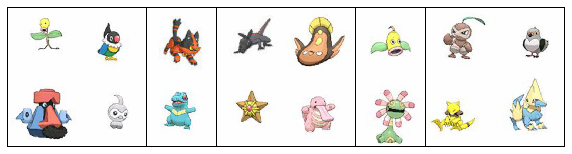

In [8]:
# Plots a sample of the processed data used for the training.

real_batch = next(iter(dataloader))
plt.figure(figsize=(10,10))
plt.axis("off")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:16], padding=2, normalize=True).cpu(),(1,2,0)))
plt.savefig(os.path.join(prefix, "test.jpg"))

## Models definition

In [0]:
# custom weights initialization called on generator and discriminator

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [0]:
# Generator Code

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        def conv_block(in_features, out_features):
          layers = [nn.ConvTranspose2d(in_features, out_features, 4, 2, 1, bias=False)]
          layers.append(nn.BatchNorm2d(out_features))
          layers.append(nn.ReLU(inplace=True))
          return layers

        self.input = nn.Sequential(
            nn.ConvTranspose2d(LATENT_VECTOR_SIZE, G_FEATURE_SIZE * 32, 4, 1, 0, bias=False),
            nn.BatchNorm2d(G_FEATURE_SIZE * 32),
            nn.ReLU(True)
        )
        
        self.conv_blocks = nn.Sequential(
            *conv_block(G_FEATURE_SIZE * 32, G_FEATURE_SIZE * 16),
            *conv_block(G_FEATURE_SIZE * 16, G_FEATURE_SIZE * 8),
            *conv_block(G_FEATURE_SIZE * 8, G_FEATURE_SIZE * 4),
            *conv_block(G_FEATURE_SIZE * 4, G_FEATURE_SIZE * 2),
            *conv_block(G_FEATURE_SIZE * 2, G_FEATURE_SIZE),
        )
        self.output = nn.Sequential(
            nn.ConvTranspose2d(G_FEATURE_SIZE, IMG_N_CHANNELS, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
      x = self.input(z)
      x = self.conv_blocks(x)
      img = self.output(x)
      return img

In [0]:
# Discriminator code

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        def conv_block(in_features, out_features):
          layers = [nn.Conv2d(in_features, out_features, 4, 2, 1, bias=False)]
          layers.append(nn.BatchNorm2d(out_features))
          layers.append(nn.LeakyReLU(0.2, inplace=True))
          return layers

        self.input = nn.Sequential(
            nn.Conv2d(IMG_N_CHANNELS, D_FEATURE_SIZE, 6, 4, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True)
        )
        
        self.conv_blocks = nn.Sequential(
            *conv_block(D_FEATURE_SIZE, D_FEATURE_SIZE * 2),
            *conv_block(D_FEATURE_SIZE * 2, D_FEATURE_SIZE * 2),
            *conv_block(D_FEATURE_SIZE * 2, D_FEATURE_SIZE * 2),
            *conv_block(D_FEATURE_SIZE * 2, D_FEATURE_SIZE * 2)
        )
        self.output = nn.Sequential(
          nn.Conv2d(D_FEATURE_SIZE * 2, 1, 4, 1, 0, bias=False),
          nn.Sigmoid()
        )

    def forward(self, img):
      x = self.input(img)
      x = self.conv_blocks(x)
      result = self.output(x)
      return result

## Training

In [12]:
# Creates the generator and the discriminator

generator = Generator().to(device)
discriminator = Discriminator().to(device)
generator.apply(weights_init)
discriminator.apply(weights_init)

summary(generator, (LATENT_VECTOR_SIZE, 1, 1))
summary(discriminator, (IMG_N_CHANNELS, IMG_SIZE, IMG_SIZE))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ConvTranspose2d-1           [-1, 2048, 4, 4]       3,276,800
       BatchNorm2d-2           [-1, 2048, 4, 4]           4,096
              ReLU-3           [-1, 2048, 4, 4]               0
   ConvTranspose2d-4           [-1, 1024, 8, 8]      33,554,432
       BatchNorm2d-5           [-1, 1024, 8, 8]           2,048
              ReLU-6           [-1, 1024, 8, 8]               0
   ConvTranspose2d-7          [-1, 512, 16, 16]       8,388,608
       BatchNorm2d-8          [-1, 512, 16, 16]           1,024
              ReLU-9          [-1, 512, 16, 16]               0
  ConvTranspose2d-10          [-1, 256, 32, 32]       2,097,152
      BatchNorm2d-11          [-1, 256, 32, 32]             512
             ReLU-12          [-1, 256, 32, 32]               0
  ConvTranspose2d-13          [-1, 128, 64, 64]         524,288
      BatchNorm2d-14          [-1, 128,

In [0]:
# Creates the optimizers

optimizer_G = torch.optim.Adam(generator.parameters(), lr=LEARNING_RATE, betas=(G_BETA_1, 0.999))
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=LEARNING_RATE, betas=(D_BETA_1, 0.999))

In [0]:
# Set the criterion

criterion = nn.BCELoss()

In [15]:
# Training Loop

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, LATENT_VECTOR_SIZE, 1, 1, device=device)
img_list = []
G_losses = []
D_losses = []
D_x = []
D_G_z = []
batches_done = 0

print("Starting Training Loop...")

# For each epoch
for epoch in range(NUM_EPOCHS):

  for i, (imgs, _) in enumerate(dataloader, 0):

    # Configure input
    real_imgs = imgs.to(device)
    b_size = real_imgs.size(0)
    labels_real = torch.full((b_size,1, 1, 1), 1, device=device)
    labels_fake = torch.full((b_size, 1, 1, 1), 0, device=device)

    # ---------------------
    #  Train Discriminator
    # ---------------------

    optimizer_D.zero_grad()

    # Sample noise as generator input
    z = torch.randn(b_size, LATENT_VECTOR_SIZE, 1, 1, device=device)

    # Generate a batch of images
    fake_imgs = generator(z)

    real_validity = discriminator(real_imgs)
    fake_validity = discriminator(fake_imgs)

    D_x.append(real_validity.mean().item())
    D_G_z.append(fake_validity.mean().item())

    # Compute loss, then gradient and perform backpropagation
    loss_D = (criterion(real_validity, labels_real) + criterion(fake_validity, labels_fake)) / 2
    loss_D.backward()
    optimizer_D.step()

    optimizer_G.zero_grad()
    # Train the generator every n_critic iterations
    if i % D_N_TRAIN == 0:
      # -----------------
      #  Train Generator
      # -----------------

      
      # Generate a batch of images
      gen_imgs = generator(z)
      # Adversarial loss
      loss_G = criterion(discriminator(gen_imgs), labels_real)

      loss_G.backward()
      optimizer_G.step()


      D_losses.append(loss_D.item())
      G_losses.append(loss_G.item())
      print(
        "[Epoch %d/%d][Batch %d/%d][D loss: %f] [G loss: %f]"
        % (epoch, NUM_EPOCHS, batches_done % len(dataloader), len(dataloader), loss_D.item(), loss_G.item())
      )   
      batches_done += D_N_TRAIN

  # Check how the generator is doing by saving G's output on fixed_noise
  if (epoch % (NUM_EPOCHS / 20) == 0) or ((epoch == NUM_EPOCHS - 1) and (i == len(dataloader) - 1)):
    with torch.no_grad():
      fake = generator(fixed_noise).detach().cpu()
      img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

Streaming output truncated to the last 5000 lines.
[Epoch 45/500][Batch 6/51][D loss: 0.048315] [G loss: 3.180031]
[Epoch 45/500][Batch 11/51][D loss: 0.113472] [G loss: 2.965958]
[Epoch 45/500][Batch 16/51][D loss: 0.048875] [G loss: 4.789820]
[Epoch 45/500][Batch 21/51][D loss: 0.021959] [G loss: 4.532916]
[Epoch 45/500][Batch 26/51][D loss: 0.047929] [G loss: 3.828582]
[Epoch 46/500][Batch 31/51][D loss: 0.604222] [G loss: 5.573692]
[Epoch 46/500][Batch 36/51][D loss: 0.038201] [G loss: 4.859597]
[Epoch 46/500][Batch 41/51][D loss: 0.066885] [G loss: 3.395296]
[Epoch 46/500][Batch 46/51][D loss: 0.045058] [G loss: 4.446128]
[Epoch 46/500][Batch 0/51][D loss: 0.050791] [G loss: 3.252172]
[Epoch 46/500][Batch 5/51][D loss: 0.044985] [G loss: 3.353328]
[Epoch 46/500][Batch 10/51][D loss: 0.021831] [G loss: 3.832676]
[Epoch 46/500][Batch 15/51][D loss: 0.060204] [G loss: 3.412538]
[Epoch 46/500][Batch 20/51][D loss: 0.035868] [G loss: 3.546023]
[Epoch 46/500][Batch 25/51][D loss: 0.0270

## Results

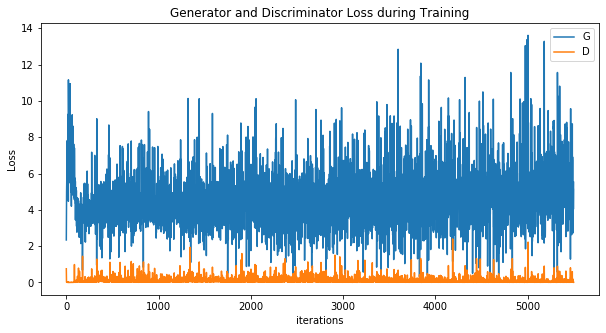

In [16]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss during Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

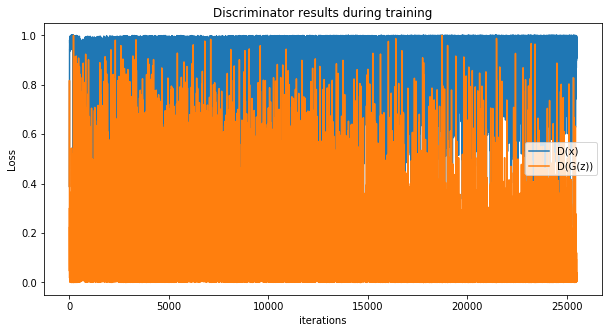

In [17]:
plt.figure(figsize=(10,5))
plt.title("Discriminator results during training")
plt.plot(D_x,label="D(x)")
plt.plot(D_G_z,label="D(G(z))")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21881363 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


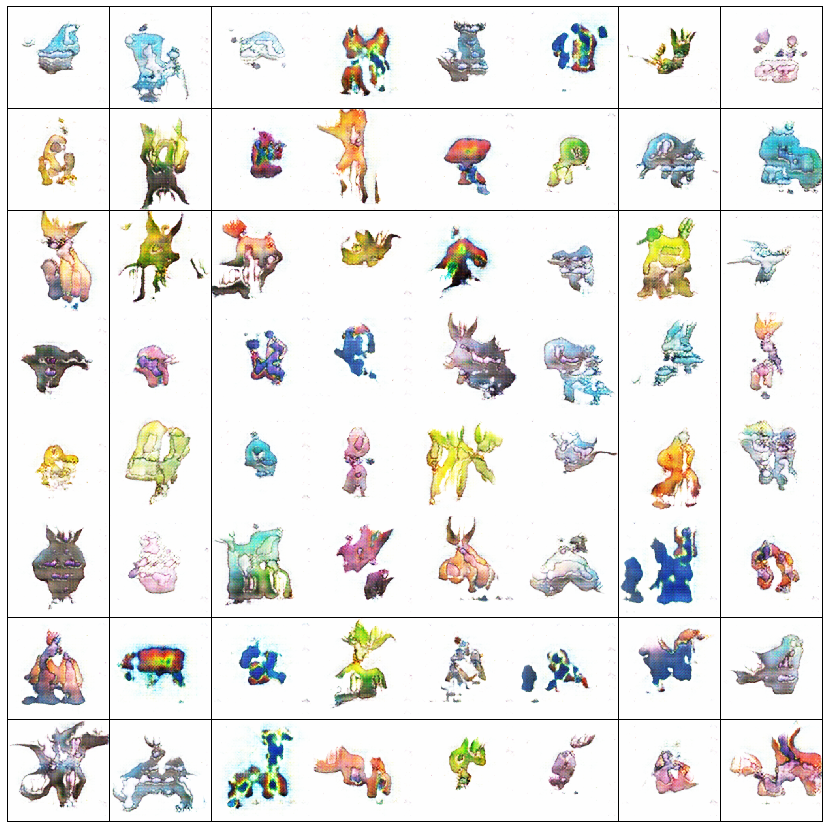

In [18]:
# Animation to visualize steps on the fixed noise

#%%capture
fig = plt.figure(figsize=(15,15))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [0]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the fake images from the last epoch
plt.figure(figsize=(15,15))
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

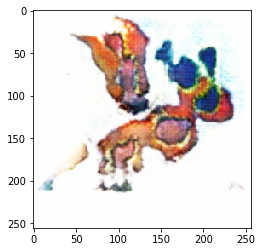

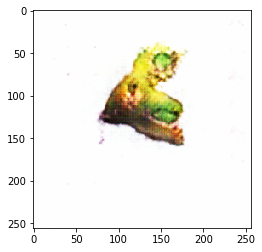

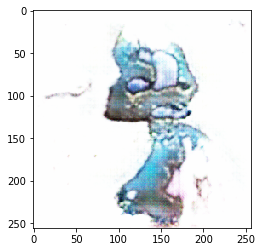

In [19]:
# Generate random pokemons (Future starters ?)

num_pokemons = 3
latent_vectors = torch.randn(num_pokemons, LATENT_VECTOR_SIZE, 1, 1, device=device)
pokemons = generator(latent_vectors).detach().cpu()

for i in range(num_pokemons):
  plt.figure()
  plt.imshow(np.transpose(vutils.make_grid(pokemons.to(device)[i], padding=5, normalize=True).cpu(),(1,2,0)))